In [ ]:
import warnings
warnings.filterwarnings('ignore')
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # or any {'0', '1', '2'}
import tensorflow as tf
import glob
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from keras.utils import plot_model
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
import keras.callbacks

## Install segmentation models from repo https://github.com/qubvel/segmentation_models

In [ ]:
from segmentation_models import Unet
from segmentation_models.backbones import get_preprocessing

In [ ]:
BACKBONE = 'vgg19'
preprocess_input = get_preprocessing(BACKBONE)
height = 512
width = 512
nClasses = 21

## Write custom generator for each batch now without augmentations

In [ ]:
def generator(train_files,train_masks,batch_size):
    num_samples=len(train_files)
    while 1:
        shuffle(train_files)
        for offset in range(0, num_samples, batch_size):
            batch_train_files = train_files[offset:offset+batch_size]
            batch_train_masks = train_masks[offset:offset+batch_size]

            train_images = []
            labels = []
            for train_image, label in zip(batch_train_files, batch_train_masks):
                image = cv2.imread(train_image,1)
                image = cv2.resize(image, (width, height))
                train_images.append(image)
                measurement = cv2.imread(label,1)
                seg_labels = np.zeros((height, width, nClasses))
                measurement = cv2.resize(measurement, (width, height))
                measurement = measurement[:,:,0]

                for c in range(nClasses):
                    seg_labels[:, :, c] = (measurement == c).astype(int)

                labels.append(seg_labels)



            
            X_train = preprocess_input(np.array(train_images))

            y_train = np.array(labels)


            yield shuffle(X_train,y_train)


## Create Telegram bot Callback 

In [ ]:
import telebot
from keras.callbacks import Callback
from telebot import apihelper
apihelper.proxy = {'*********'} ##Use your proxy


class TelegramCallback(Callback):

    def __init__(self, config, name=None):
        super(TelegramCallback, self).__init__()
        self.user_id = config['telegram_id']
        self.bot = telebot.TeleBot(config['token'])

        if name != None:
            self.name = name
        else:
            self.name = self.model.name

    def send_message(self, text):
        try:
            self.bot.send_message(chat_id=self.user_id, text=text)
        except Exception as e:
            print('Message did not send. Error: {}.'.format(e))

    def on_train_begin(self, logs={}):
        text = 'Start training model {}.'.format(self.name)
        self.send_message(text)

    def on_train_end(self, logs={}):
        text = 'Training model {} ended.'.format(self.name)
        self.send_message(text)

    def on_epoch_end(self, epoch, logs={}):
        text = '{}: Epoch {}.\n'.format(self.name, epoch)
        for k, v in logs.items():
            if k != "lr":
                text += '{}: {:.4f}; '.format(k, v)
            else:
                text += '{}: {:.6f}; '.format(k, v) #4 decimal places too short for learning rate
        self.send_message(text)


## Download dataset from http://wilddash.cc/railsem19 and unpack it

In [22]:
trainpath = os.path.join('/datasets/workspace/foreign/RS2019/jpgs/rs19_val', '*')
train_mask_path = os.path.join('/datasets/workspace/foreign/RS2019/uint8/rs19_val', '*')
# Load training images
train_files = sorted(glob.glob(trainpath))
train_masks = sorted(glob.glob(train_mask_path))
test_files = train_files[-10:]
test_masks = train_masks[-10:]
train_files = train_files[:-10]
train_masks = train_masks[:-10]

## Define colors for classes

In [ ]:
colors = [(70,70,70),
          (128,64,128),
          (0,255,0),
          (100,80,0),
          (232, 35, 244),
          (255, 255, 0),
          (127, 255, 0),
          (255,0,0),
          (0,0,255),
          (191, 191, 0),
          (0, 255, 127),
          (0, 220, 220),
          (30, 170, 250),
          (0, 85, 125),
          (60, 20, 220),
          (142, 0, 0),
          (153, 153, 190),
          (60, 20, 220),
          (153, 153, 153),
          (255, 255, 255),
          (70, 0, 0)
]

## Convert single layer grayscaled image to color-image

In [ ]:
def gray_to_rgb(mask):
    seg_img = np.zeros((mask.shape[0], mask.shape[1], 3))
    for c in range(nClasses):
        seg_img[:, :, 0] += ((mask  == c) * (colors[c][0])).astype('uint8')
        seg_img[:, :, 1] += ((mask  == c) * (colors[c][1])).astype('uint8')
        seg_img[:, :, 2] += ((mask  == c) * (colors[c][2])).astype('uint8')

    seg_img = cv2.resize(seg_img, (mask.shape[1], mask.shape[0])).astype(np.uint8)
    return seg_img

## Show some dataset files and masks

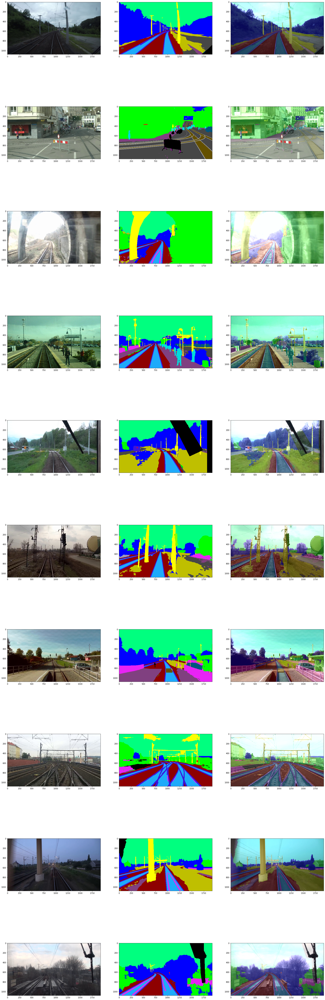

In [24]:
max_images = 10
grid_width_dataset = 3

fig, axs_imgs = plt.subplots(max_images, grid_width_dataset, figsize=(grid_width_dataset*10, max_images*10))
for i, (pic_file, mask_file) in enumerate(zip(train_files[:max_images], train_masks[:max_images])):
    pic = cv2.imread(pic_file)
    pic = cv2.cvtColor(pic, cv2.COLOR_BGR2RGB)
    mask = cv2.imread(mask_file)
    ax_1 = axs_imgs[i, 0]
    ax_2 = axs_imgs[i, 1]
    ax_3 = axs_imgs[i, 2]
    mask = gray_to_rgb(mask[:,:,0])
    ax_1.imshow(pic)
    ax_2.imshow(mask)
    ax_3.imshow (cv2.addWeighted(pic, 1, mask, 0.3, 0))

## Loading Unet model with vgg19 encoder, pretrained on ImageNet

In [ ]:
model = Unet(BACKBONE, classes=nClasses, activation='softmax')
model.compile('Adam', loss='categorical_crossentropy', metrics=['categorical_accuracy'])
model.summary()

## Training process

In [11]:
max_epochs = 200
batch_size = 8
train_samples, validation_samples, train_masks, validation_masks = train_test_split(train_files, train_masks, test_size=0.2,random_state=17)
train_generator = generator(train_samples,train_masks,batch_size=batch_size)
validation_generator = generator(validation_samples,validation_masks,batch_size=batch_size)
tb_call_back = keras.callbacks.TensorBoard(log_dir='/media/dnikitin/work/GIT/VagonSegmentator/logs', histogram_freq=0,
                                             write_graph=True, write_images=True)
tb_call_back.set_model(model)
callback_early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001, patience=6, verbose=1,
                                                            mode='min')
callback_model_checkpoint = keras.callbacks.ModelCheckpoint('unet_vgg19_21_class_512X512.h5', monitor='val_loss', verbose=1,
                                                                save_best_only=True,
                                                                save_weights_only=False, mode='min')

callback_reduce_on_plateau = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=4,
                                                                   verbose=1, mode='auto', cooldown=0, min_lr=0)
    # create callback
config = {
        'token': '**********',  # paste your bot token
        'telegram_id': ******,  # paste your telegram_id
    }
tg_callback = TelegramCallback(config, name=model.name)
history = model.fit_generator(generator=train_generator, \
                                  steps_per_epoch=len(train_samples) / batch_size, \
                                  epochs=max_epochs, \
                                  verbose=1, \
                                  validation_data=validation_generator, \
                                  validation_steps=len(validation_samples) / batch_size, \
                                  callbacks=[callback_reduce_on_plateau, callback_model_checkpoint, \
                                             callback_early_stopping, tb_call_back, tg_callback])

849/849 [==============================] - 1796s 2s/step - loss: 1.2199 - categorical_accuracy: 0.5847 - val_loss: 1.3022 - val_categorical_accuracy: 0.5435

Epoch 00001: val_loss improved from inf to 1.30221, saving model to unet_vgg19_21_class_512X512.h5
Epoch 2/200
849/849 [==============================] - 1718s 2s/step - loss: 0.9096 - categorical_accuracy: 0.6782 - val_loss: 0.8722 - val_categorical_accuracy: 0.6930

Epoch 00002: val_loss improved from 1.30221 to 0.87220, saving model to unet_vgg19_21_class_512X512.h5
Epoch 3/200
849/849 [==============================] - 1624s 2s/step - loss: 0.8168 - categorical_accuracy: 0.7081 - val_loss: 0.7983 - val_categorical_accuracy: 0.7189

Epoch 00003: val_loss improved from 0.87220 to 0.79834, saving model to unet_vgg19_21_class_512X512.h5
Epoch 4/200
849/849 [==============================] - 1640s 2s/step - loss: 0.7516 - categorical_accuracy: 0.7291 - val_loss: 0.7402 - val_categorical_accuracy: 0.7345

Epoch 00004: val_loss impro

## Training results

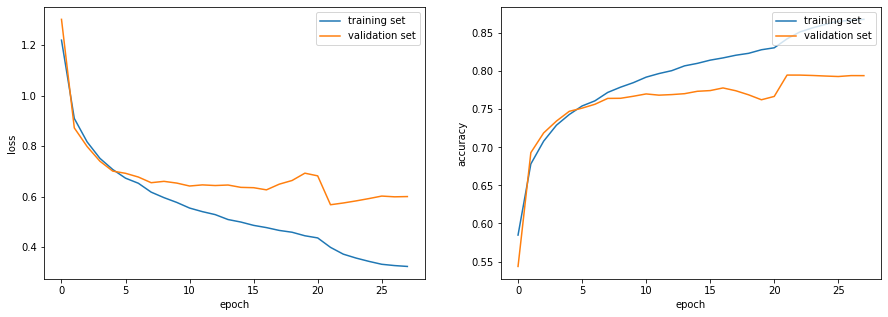

In [13]:
fig, (ax_loss, ax_acc) = plt.subplots(1, 2, figsize=(15,5))
ax_loss.set_ylabel('loss')
ax_loss.set_xlabel('epoch')
ax_loss.plot(history.epoch, history.history["loss"], label="Train loss")
ax_loss.plot(history.epoch, history.history["val_loss"], label="Validation loss")
ax_loss.legend(['training set', 'validation set'], loc='upper right')
ax_acc.set_ylabel('accuracy')
ax_acc.set_xlabel('epoch')
ax_acc.plot(history.epoch, history.history["categorical_accuracy"], label="Train accuracy")
ax_acc.plot(history.epoch, history.history["val_categorical_accuracy"], label="Validation accuracy")
ax_acc.legend(['training set', 'validation set'], loc='upper right')

In [14]:
from keras.models import load_model

In [18]:
def check_model(files, ground_truth_masks):
    grid_width = 4
    fig, axs = plt.subplots(max_images, grid_width, figsize=(grid_width*10, len(files)*10))
    for i, (pic_file, mask_file) in enumerate(zip(files, ground_truth_masks)):
        test_pic = cv2.imread(pic_file)
        gt_mask = cv2.imread(mask_file)
        small_img = cv2.resize(test_pic, (height, width))
        test_pic = cv2.cvtColor(test_pic, cv2.COLOR_BGR2RGB)
        small_img = np.array(small_img)
        small_img = small_img[None,:,:,:]
        preprocessed_image = preprocess_input(small_img)
        prediction = model.predict(preprocessed_image)[0]
        pred = np.zeros_like(prediction)
        pred[(prediction > 0.7)] = 1
        single_layer = np.argmax(pred, axis=-1)
        result_image = gray_to_rgb(single_layer)
        result_image = cv2.resize(result_image, (test_pic.shape[1], test_pic.shape[0])).astype(np.uint8)
        ax = axs[i, 0]
        ax2 = axs[i, 1]
        ax3 = axs[i, 2]
        ax4 = axs[i,3]
        ax.imshow(test_pic)
        ax2.imshow(result_image)
        ax3.imshow(gray_to_rgb(gt_mask[:,:,0]))
        ax4.imshow (cv2.addWeighted(test_pic, 1, result_image, 0.5, 0))

    
    
    

## Check Unet with vgg19 encoder

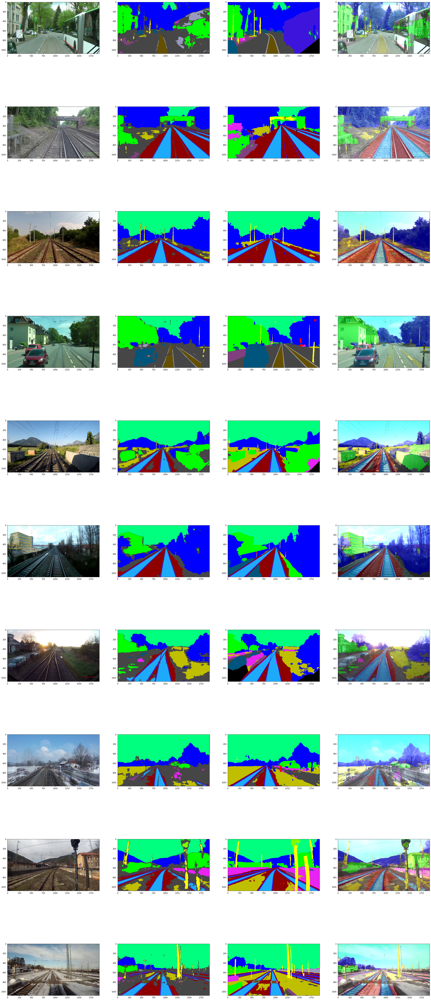

In [25]:
model = load_model('unet_vgg19_21_class_512X512.h5')
check_model(test_files, test_masks)

## Check Unet with resnet34 encoder

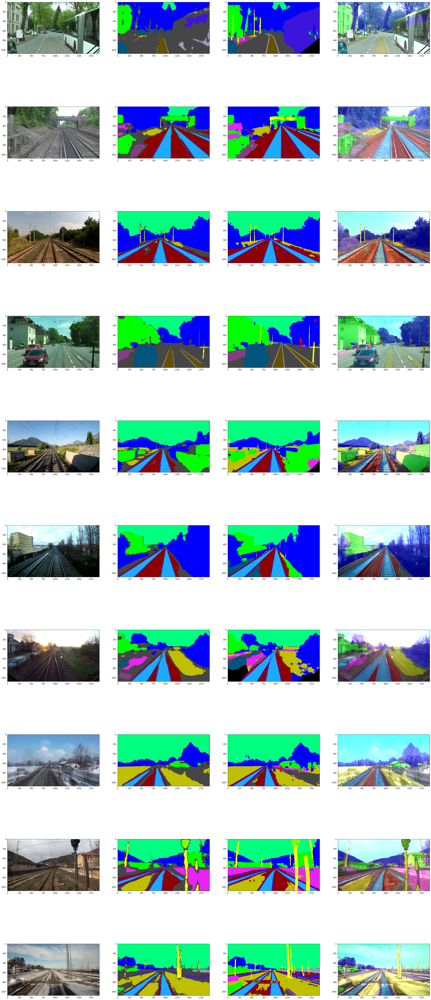

In [26]:
BACKBONE = 'resnet34'
preprocess_input = get_preprocessing(BACKBONE)
height = 224
width = 224
model = load_model('/home/dnikitin/Desktop/models/unet/unet_resnet_34_21_class_224X224.h5')
check_model(test_files, test_masks)

## Check unet with resnet 101 encoder

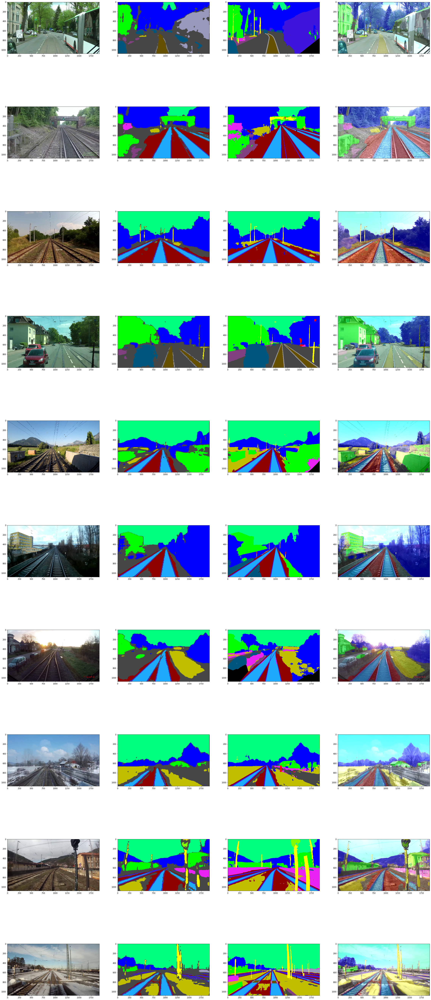

In [29]:
BACKBONE = 'resnet101'
preprocess_input = get_preprocessing(BACKBONE)
height = 224
width = 224
model = load_model('/home/dnikitin/Desktop/models/unet/Unet_resnet_101_21_class_224X224.h5')
check_model(test_files, test_masks)

## Check FPN with resnet 34 encoder 

W0821 11:36:31.796866 139838094337856 deprecation_wrapper.py:119] From /home/dnikitin/.local/lib/python3.6/site-packages/segmentation_models/common/functions.py:98: The name tf.image.resize_bilinear is deprecated. Please use tf.compat.v1.image.resize_bilinear instead.



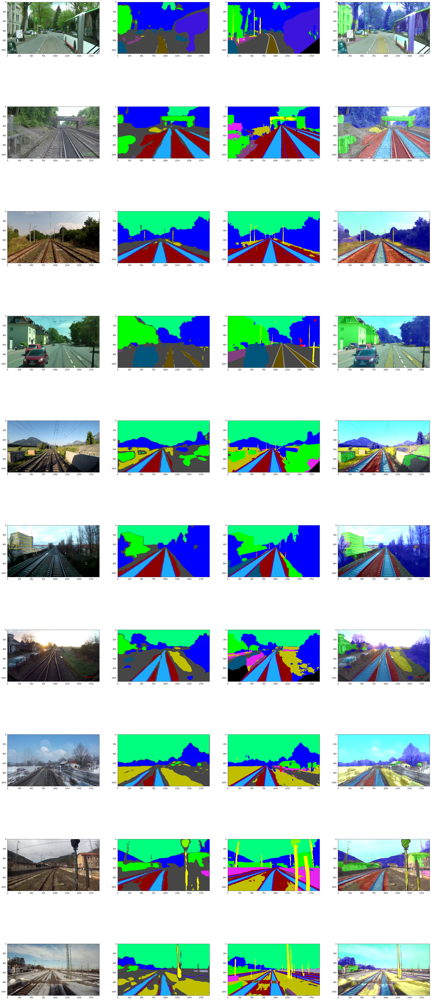

In [31]:
BACKBONE = 'resnet34'
preprocess_input = get_preprocessing(BACKBONE)
height = 224
width = 224
model = load_model('/home/dnikitin/Desktop/models/fpn/FPN_resnet_34_21_class_224X224.h5')
check_model(test_files, test_masks)

## Check FPN with resnet 101 encoder

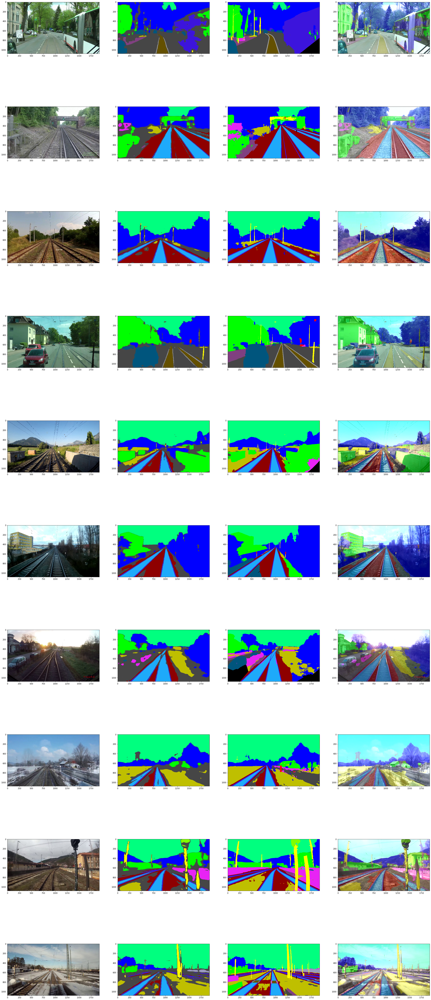

In [32]:
BACKBONE = 'resnet101'
preprocess_input = get_preprocessing(BACKBONE)
height = 384
width = 384
model = load_model('/home/dnikitin/Desktop/models/fpn/FPN_resnet_101_21_class_384X384.h5')
check_model(test_files, test_masks)